# Quel effet de l'encadrement des loyers sur les prix de l'immobilier ? 


# Introduction 

Ce projet Python s'inscrit dans l'appréhension du débat public existant autour de l'efficacité économique de la mise en place de l'encadrement des loyers dans certaines agglomérations (Paris, Lyon, Bordeaux...) considérées comme "zones tendues". Ces villes sont en effet caractérisées par un déséquilibre entre offre et demande de logements et un prix des loyers croissant. 
Dans un [article publié en 2019 dans _American Economic Review_](https://www.aeaweb.org/articles?id=10.1257/aer.20181289) , des chercheurs de l'Université de Stanford ont modélisé les effets de l'introduction d'un contrôle des loyers à San Francisco dans les années 1990. Leurs recherches démontrent alors que cette mesure n'est pas sans conséquences économiques sur le parc immobilier de la ville. Elle est en effet à l'origine une forte baisse de l'offre locative mais également d'une mobilité des habitants moindre avec un renouvellement résidentiel plus faible du parc locatif.

Ainsi, quel est l'effet de l'encadrement des loyers sur les prix de l'immobilier ? 

L'objectif principal de notre travail est également d'étudier plus largement, à partir des base de données DVF et filosofy de l'INSEE, les effets de cette politique du logement très souvent discutée dans le débat politique, sur l'évolution des prix moyen et médian d'achat et l'offre de transactions immobilières. En effet, la relation intrinsèque entre encadrement des loyers et évolution des tendances sur le marché immobilier semble relativement complexe et dépendante de nombreux facteurs sociaux, économiques et politiques. On peut en effet supposer que du fait de la réduction des revenus locatifs engendrée par l'encadrement des loyers, les investisseurs anticipent des rendements plus faibles et sont donc moins enclins à acheter des biens immobiliers, ce qui pourrait freiner ou réduire les prix. Par ailleurs, il est également possible d'émettre l'hypothèse que les investisseurs se reportent alors vers des zones non soumises à encadrement, augmentant alors potentiellement la demande et le prix dans ces zones.

Par l'application d'un modèle "difference-in-difference" sur différentes zones géographiques soumises et non soumises à l'encadrement des loyers et la réalisation de statistiques descriptives, nous souhaitons donc voir si il est possible de véritablement mesurer ces évolutions et finalement d'infirmer ou confirmer ces hypothèses aux effets contraires en identifiant les effets de l'encadrement des loyers sur les prix de l'immobilier. 

# Installation 

In [89]:
!pip install py7zr geojson geopandas openpyxl tqdm s3fs
!pip install PyYAML xlrd
!pip install git+https://github.com/inseefrlab/cartiflette

  Cloning https://github.com/inseefrlab/cartiflette to /tmp/pip-req-build-rk3ewn20
  Running command git clone --filter=blob:none --quiet https://github.com/inseefrlab/cartiflette /tmp/pip-req-build-rk3ewn20
^C
ERROR: Operation cancelled by user


In [ ]:
import pandas as pd
import numpy as np
import geopandas as gpd
import geojson
import requests
import time
import os
import re
import magic
import matplotlib.pyplot as plt
import zipfile
import cartiflette
from io import StringIO

This is an experimental version of cartiflette published on PyPi.
To use the latest stable version, you can install it directly from GitHub with the following command:
pip install git+https://github.com/inseeFrLab/cartiflette.git


# Préparation des données : 

## I. Importation des données DVF

### A. Paramétrage de l'API

On commence d'abord par paramétrer l'API pour pouvoir importer les données DVF.

In [ ]:
def cleaning_json_for_gpd(data):
    for feature in data["features"]:
        properties = feature["properties"]
        for key, value in properties.items():
            if isinstance(value, list):  # Vérifie si c'est une liste
                properties[key] = ", ".join(map(str, value))  # Convertit en chaîne séparée par des virgules

In [ ]:
def recup_donnees_dvf(code_insee,annee_mut):
        url = base_api_dvf_url + f"/dvf_opendata/geomutations/?anneemut={annee_mut}&code_insee={code_insee}&page_size=300"
        response = requests.get(url)
        data = response.json()
        cleaning_json_for_gpd(data)
        mut_gdf_tempo = gpd.GeoDataFrame.from_features(data["features"])
        col_mut = mut_gdf_tempo.columns
        mut_gdf = gpd.GeoDataFrame(columns=col_mut)

        while url != None : 
                response = requests.get(url)
                if response.status_code == 200:
                        data = response.json()
                        url = data['next']
                        cleaning_json_for_gpd(data) #transforme le dictionary qu'est data en un dataframe
                        mut_gdf_tempo = gpd.GeoDataFrame.from_features(data["features"])
                        mut_gdf = pd.concat([mut_gdf, mut_gdf_tempo], axis=0)
                    
                else:
                        print(f"Erreur : {response.status_code}")
                        url = None

        return mut_gdf

In [ ]:
def recup_donnees_dvf_all_years(code_insee):
        url = base_api_dvf_url + f"/dvf_opendata/geomutations/?code_insee={code_insee}&page_size=500"
        response = requests.get(url)
        data = response.json()
        cleaning_json_for_gpd(data)
        mut_gdf_tempo = gpd.GeoDataFrame.from_features(data["features"])
        col_mut = mut_gdf_tempo.columns
        mut_gdf = gpd.GeoDataFrame(columns=col_mut)

        while url != None : 
                response = requests.get(url)
                if response.status_code == 200:
                        data = response.json()
                        url = data['next']
                        print(url)
                        cleaning_json_for_gpd(data) #transforme le dictionary qu'est data en un dataframe
                        mut_gdf_tempo = gpd.GeoDataFrame.from_features(data["features"])
                        mut_gdf = pd.concat([mut_gdf, mut_gdf_tempo], axis=0)
                    
                else:
                        print(f"Erreur : {response.status_code}")
                        url = None

        return mut_gdf

On écrit la racine de l'API : 

In [ ]:
base_api_dvf_url = "https://apidf-preprod.cerema.fr"

Pour réaliser notre étude comparative, on souhaite récupérer les données DVF des villes suivantes : 
1. **Zone ouest** :
- Paris 16 : 75116
- Paris 17: 75117 où l'encadrement des loyers est appliqué dans les 2 arrondissements depuis 2019.
- Clichy : 92024
- Levallois : 92044
- Neuilly : 92051
- Boulogne-Billancourt : 92012

2. **Zone sud**
- Paris 13 : 75113
- Paris 14 : 75114
- Paris 15 : 75115 où l'encadrement des loyers est appliqué dans les 3 arrondissements depuis 2019.
- Issy-les-Moulineaux : 92040
- Vanves : 92075
- Malakoff : 92046
- Montrouge : 92049
- Gentilly : 94037
- Ivry-sur-Seine : 94041


On constate en faisant tourner naïvement l'API qu'on obtient toujours des données par paquets en nombre limité (par défaut, 100). On peut modifier cela par le paramètre "page_size", mais la limite est de 500. Pour un paramètre supérieur à 500, on n'obtient que des pages de 500. 

On cherche donc à faire boucler nos requêtes à l'API jusqu'à obtenir toutes les données concernant la commune qui nous intéresse. Or on constate que la réponse "data" que l'on obtient possède une clé "next", qui donne l'url de notre requête complété par un argument "page". L'API fonctionne donc ainsi : s'il y a plus de 500 observations pour une commune, l'API nous renvoie une première page qui contient 500 observations, avec l'url pour requêter la page suivant qui contient 500 autres observations, et ainsi de suite jusqu'à la dernière page, qui donne pour valeur "None" à la clé "next". 

Le code ci-dessous permet de récupérer les données.

In [ ]:
"""data_dvf_sud = recup_donnees_dvf("92040",2014) 

code_insee_ville_banlieue_sud = ["92040", "92075", "92046", "92049", "94037", "94041"]
code_insee_arrond_sud = ["75113", "75114", "75115"]

for code_insee_ville in code_insee_ville_banlieue_sud: 
    print(code_insee_ville)
    for annee in range(2013,2022):
        print(annee)
        data_temp = recup_donnees_dvf(code_insee_ville,str(annee))
        data_dvf_sud = pd.concat([data_dvf_sud, data_temp], axis = 0)

data_dvf_sud.shape"""

'data_dvf_sud = recup_donnees_dvf("92040",2014) \n\ncode_insee_ville_banlieue_sud = ["92040", "92075", "92046", "92049", "94037", "94041"]\ncode_insee_arrond_sud = ["75113", "75114", "75115"]\n\nfor code_insee_ville in code_insee_ville_banlieue_sud: \n    print(code_insee_ville)\n    for annee in range(2013,2022):\n        print(annee)\n        data_temp = recup_donnees_dvf(code_insee_ville,str(annee))\n        data_dvf_sud = pd.concat([data_dvf_sud, data_temp], axis = 0)\n\ndata_dvf_sud.shape'

In [ ]:
"""data_dvf_sud = recup_donnees_dvf_all_years("92040") 

code_insee_ville_banlieue_sud = ["92075", "92046", "92049", "94037", "94041"]
code_insee_arrond_sud = ["75113", "75114", "75115"]

for code_insee_ville in code_insee_ville_banlieue_sud: 
    print(code_insee_ville)
    data_temp = recup_donnees_dvf_all_years(code_insee_ville)
    data_dvf_sud = pd.concat([data_dvf_sud, data_temp], axis = 0)

data_dvf_sud.shape"""

'data_dvf_sud = recup_donnees_dvf_all_years("92040") \n\ncode_insee_ville_banlieue_sud = ["92075", "92046", "92049", "94037", "94041"]\ncode_insee_arrond_sud = ["75113", "75114", "75115"]\n\nfor code_insee_ville in code_insee_ville_banlieue_sud: \n    print(code_insee_ville)\n    data_temp = recup_donnees_dvf_all_years(code_insee_ville)\n    data_dvf_sud = pd.concat([data_dvf_sud, data_temp], axis = 0)\n\ndata_dvf_sud.shape'

In [ ]:
#data_dvf_sud.shape

Difficulté : l'API peut arrêter de nous répondre de manière imprévue au milieu de la boucle de requête des pages. Dans ce cas, toutes les données obtenues sur les pages précédentes sont perdues. On a donc intérêt, pour pouvoir travailler sereinement, à télécharger ces données. 

Pour ce faire, on va essayer, commune par commune, de requêter toutes les pages, et, AVANT de passer au requêtage pour la commune suivante, on sauvegarde notre geodataframe au format geojson. 

In [ ]:
"""code_insee_pour_enregistre = ["92012"]
for code_insee in code_insee_pour_enregistre: 
    url = base_api_dvf_url + f"/dvf_opendata/geomutations/?code_insee={code_insee}&page_size=100"
    response = requests.get(url)
    data = response.json()
    print(data['count'])
    gdf = recup_donnees_dvf_all_years(code_insee)
    name = f'data/dvf/data_code_insee={code_insee}.geojson'
    gdf.to_file(name, driver="GeoJSON")
    gdf = gpd.read_file(name)
    print(len(gdf))"""

'code_insee_pour_enregistre = ["92012"]\nfor code_insee in code_insee_pour_enregistre: \n    url = base_api_dvf_url + f"/dvf_opendata/geomutations/?code_insee={code_insee}&page_size=100"\n    response = requests.get(url)\n    data = response.json()\n    print(data[\'count\'])\n    gdf = recup_donnees_dvf_all_years(code_insee)\n    name = f\'data/dvf/data_code_insee={code_insee}.geojson\'\n    gdf.to_file(name, driver="GeoJSON")\n    gdf = gpd.read_file(name)\n    print(len(gdf))'

On fait pareil pour la zone ouest de Paris

In [ ]:
"""data_dvf_ouest_banlieue = recup_donnees_dvf("92040",2014) 

code_insee_ville_banlieue_ouest = ["92040", "92075", "92046", "92049", "94037", "94041"]

for code_insee_ville in code_insee_ville_banlieue_ouest: 
    print(code_insee_ville)
    for annee in range(2013,2022):
        print(annee)
        data_temp = recup_donnees_dvf(code_insee_ville,str(annee))
        data_dvf_ouest = pd.concat([data_dvf_ouest, data_temp], axis = 0)

data_dvf_ouest_banlieue.shape"""

'data_dvf_ouest_banlieue = recup_donnees_dvf("92040",2014) \n\ncode_insee_ville_banlieue_ouest = ["92040", "92075", "92046", "92049", "94037", "94041"]\n\nfor code_insee_ville in code_insee_ville_banlieue_ouest: \n    print(code_insee_ville)\n    for annee in range(2013,2022):\n        print(annee)\n        data_temp = recup_donnees_dvf(code_insee_ville,str(annee))\n        data_dvf_ouest = pd.concat([data_dvf_ouest, data_temp], axis = 0)\n\ndata_dvf_ouest_banlieue.shape'

In [ ]:
"""data_dvf_ouest_paris = recup_donnees_dvf("75116",2012)

code_insee_arrond_ouest = ["75116", "75117"]

for code_insee_ville in code_insee_arrond_ouest: 
    print(code_insee_ville)
    for annee in range(2013,2022):
        print(annee)
        data_temp = recup_donnees_dvf(code_insee_ville,str(annee))
        data_dvf_ouest_paris = pd.concat([data_dvf_ouest_paris, data_temp], axis = 0)
"""

'data_dvf_ouest_paris = recup_donnees_dvf("75116",2012)\n\ncode_insee_arrond_ouest = ["75116", "75117"]\n\nfor code_insee_ville in code_insee_arrond_ouest: \n    print(code_insee_ville)\n    for annee in range(2013,2022):\n        print(annee)\n        data_temp = recup_donnees_dvf(code_insee_ville,str(annee))\n        data_dvf_ouest_paris = pd.concat([data_dvf_ouest_paris, data_temp], axis = 0)\n'

Ci-dessous, le code pour reconstituer les fichiers geojson à partir des sauvegardes faites à cause de l'API défectueuse (en deux temps : la zone ouest puis la zone sud)

In [ ]:
obs_tot = 0
list_gpd_ouest = []
for geo_file in os.listdir("data/dvf/cluster_ouest"): 
    geo_file_temp = gpd.read_file("data/dvf/cluster_ouest/"+geo_file)  
    list_gpd_ouest.append(geo_file_temp)
    obs_tot += len(geo_file_temp)

all_gpd_ouest = pd.concat(list_gpd_ouest)
print(len(all_gpd_ouest), obs_tot)

134410 134410


In [ ]:
obs_tot = 0
list_gpd_sud = []
for geo_file in os.listdir("data/dvf/cluster_sud"): 
    geo_file_temp = gpd.read_file("data/dvf/cluster_sud/"+geo_file)  
    obs_tot += len(geo_file_temp)
    list_gpd_sud.append(geo_file_temp)

all_gpd_sud = pd.concat(list_gpd_sud)
print(len(all_gpd_sud), obs_tot)

119319 119319


### B- Description des variables de ce dataframe :
- idmutinvar = identifiant unique entre les diff bases pour retrouver chaque mutation
- idopendata = identifiant de mutation utilisé depuis l'ouverture de données DVF
- datemut = date de signature de l'acte de vente
- anneemut = annee de signature du doc
- codedep
- libnatmut = Libellé de nature de mutation tel que défini dans la donnée source DVF 6 catégories : Vente, Vente en l'état futur d'achèvement, Adjudication, Echange, Vente terrain à bâtir et Expropriation.
- vefa = booléen selon si la vente est en VEFA (vente en l'état futur d'achèvement) ou non
- valeurfonc = valeur foncière en euro déclarée lors de la vente ; prix net vendeur, inclut la TVA mais n'inclut pas les frais de notaire, d'agence ou des meubles. 
- nbcomm = nombre de communes concernée par la mutation (i.e. sur lesquelles se trouve la parcelle cadastrale concernée par la mutation)
- nbpar = comme nbcomm mais pour les parcelles.
- nbparmut = nb de parcelles ayant muté (i.e. dont la pleine propriété a été transférée lors de la mutation)
- sterr = surface de terrain ayant muté (mutation = transfert de propriété, donc surface de terrain ayant muté = surface du terrain qui a été vendu)
- nbvolmut = variable obscure, flemme 
- nblocmut = nb de locaux ayant muté
- sbati = surface de l'ensemble du bati ayant muté
- codtypbien = typologie des biens ; on pourra s'en servir pour filter les maisons et appartements et virer tous les types de batiments bizarres (cf schéma ici) https://doc-datafoncier.cerema.fr/doc/dv3f/mutation/codtypbien
- libtypbien = comme codtypbien mais pour la base DV3F et non issu de juste DVF
- geometry
- l_codeinsee = liste des codes INSEE des communes concernées par la mutation
- l_idpar =Liste des idpar qui composent l’entité (idpar = Identifiant de parcelle)
- l_idparmut = liste des identifiants de parcelles ayant muté (idpar)
- l_idlocmut = liste des identifiants de locaux ayant muté (idloc)

## II. Récupération de données Insee par IRIS pour avoir des variables de contrôle dans notre régression

Il n'y a pas d'API permettant de récupérer les données voulues par IRIS, donc on doit passer par l'importation de tous les fichiers en format csv. On importe trois types de fichiers : un qui contient des informations sur le revenu disponible ('BASE_TD_FILO_DISP_IRIS), un qui donne des informations sur les logements ('base_ic_logement') et un sur les occupations professionnelles des habitants de l'IRIS ('base-ic-activite-residents').

In [ ]:
dfs_activite = []
dfs_logement = []
dfs_revenu = []
dates_df = []


for f in os.listdir("data/insee"):
    if f.lower().endswith(".zip"): #si c'est un zip
        print(f)
        zip_file = zipfile.ZipFile("data/insee/"+f) #on le dézipe
        nom_racine_dossier = f.rsplit(".",1)[0]
        for f_in_zip in zipfile.ZipFile("data/insee/"+f).namelist():
            if f_in_zip[0:4] == "meta" :
                pass
            else :
                nom_racine_fichier = f_in_zip.rsplit(".",1)[0]
                extension = f_in_zip.rsplit(".",1)[1] #on récupère l'extension
                
                # Recherche de l'année
                schema_date = r"(\d{4})"
                match = re.search(schema_date, f)
                    
                annee_extraite = match.group(1)
                
                if extension.lower() == "csv":
                    df_temp = pd.read_csv(zip_file.open(nom_racine_fichier + "." + extension), 
                                            sep = ";", dtype = {'IRIS' : str})
                                            
                elif extension in ("xls", "xlsx"):
                    df_temp = pd.read_excel(zip_file.open(nom_racine_fichier + "." + extension),
                                            skiprows = 5, dtype = {'IRIS' : str})
                    
                df_temp['IRIS'] = df_temp['IRIS'].apply(lambda x: '0' + x if len(x) == 8 else x)
                
                deux_derniers_chiffres_annee = annee_extraite[2:4]
                df_temp['annee'] = annee_extraite
                
                if "activite" in nom_racine_fichier:
                    df_temp.columns = [col.replace(f'{deux_derniers_chiffres_annee}_', '_') for col in df_temp.columns]
                    dfs_activite.append(df_temp)
                elif "logement" in nom_racine_fichier:
                    df_temp.columns = [col.replace(f'{deux_derniers_chiffres_annee}_', '_') for col in df_temp.columns]
                    dfs_logement.append(df_temp)
                elif "DISP" in nom_racine_fichier:
                    colonnes_a_traiter = [col for col in df_temp.columns if col.endswith(deux_derniers_chiffres_annee)]
                    df_temp = df_temp.rename(columns={col: col[:-2] for col in colonnes_a_traiter})
                    dfs_revenu.append(df_temp)
                else :
                    print('un fichier n a pas été traité')

                dates_df.append(annee_extraite)
    else :
        nom_racine_fichier = f.rsplit(".",1)[0]
        extension = f.rsplit(".",1)[1] #on récupère l'extension
                
        schema_date = r"(\d{4})"
        match = re.search(schema_date, f)     
        annee_extraite = match.group(1)

        df_temp = pd.read_excel("data/insee/" + nom_racine_fichier + "." + extension,
                                            skiprows = 5, dtype = {'IRIS' : str})
                    
        df_temp['IRIS'] = df_temp['IRIS'].apply(lambda x: '0' + x if len(x) == 8 else x)
        deux_derniers_chiffres_annee = annee_extraite[2:4]
        df_temp['annee'] = annee_extraite
                
        if "DISP" in nom_racine_fichier:
            colonnes_a_traiter = [col for col in df_temp.columns if col.endswith(deux_derniers_chiffres_annee)]
            df_temp = df_temp.rename(columns={col: col[:-2] for col in colonnes_a_traiter})
            dfs_revenu.append(df_temp)

        dates_df.append(annee_extraite)


BASE_TD_FILO_DISP_IRIS_2018.zip
BASE_TD_FILO_IRIS_2021_DISP_CSV.zip
base-ic-activite-residents-2014.zip


base-ic-activite-residents-2019_csv.zip


/tmp/ipykernel_32377/2103325727.py:26: DtypeWarning: Columns (1,4) have mixed types. Specify dtype option on import or set low_memory=False.
  df_temp = pd.read_csv(zip_file.open(nom_racine_fichier + "." + extension),


base-ic-activite-residents-2017_csv.zip


/tmp/ipykernel_32377/2103325727.py:26: DtypeWarning: Columns (1,4) have mixed types. Specify dtype option on import or set low_memory=False.
  df_temp = pd.read_csv(zip_file.open(nom_racine_fichier + "." + extension),


base-ic-activite-residents-2018_csv.zip


/tmp/ipykernel_32377/2103325727.py:26: DtypeWarning: Columns (1,4) have mixed types. Specify dtype option on import or set low_memory=False.
  df_temp = pd.read_csv(zip_file.open(nom_racine_fichier + "." + extension),


BASE_TD_FILO_DISP_IRIS_2020_CSV.zip
base-ic-logement-2020_csv.zip


/tmp/ipykernel_32377/2103325727.py:26: DtypeWarning: Columns (1,3) have mixed types. Specify dtype option on import or set low_memory=False.
  df_temp = pd.read_csv(zip_file.open(nom_racine_fichier + "." + extension),


BASE_TD_FILO_DISP_IRIS_2019.zip
base-ic-activite-residents-2016.zip
base-ic-activite-residents-2020_csv.zip


/tmp/ipykernel_32377/2103325727.py:26: DtypeWarning: Columns (1,3) have mixed types. Specify dtype option on import or set low_memory=False.
  df_temp = pd.read_csv(zip_file.open(nom_racine_fichier + "." + extension),


BASE_TD_FILO_DISP_IRIS_2020_XLSX.zip
base-ic-logement-2015.zip
base-ic-activite-residents-2015.zip
base-ic-logement-2021_csv.zip


/tmp/ipykernel_32377/2103325727.py:26: DtypeWarning: Columns (1,3,80,81,82,83,84,85,90,91,92,93) have mixed types. Specify dtype option on import or set low_memory=False.
  df_temp = pd.read_csv(zip_file.open(nom_racine_fichier + "." + extension),


base-ic-logement-2014.zip
base-ic-logement-2019_csv.zip


/tmp/ipykernel_32377/2103325727.py:26: DtypeWarning: Columns (1,4,81,82,83,84,85,86,91,92,93,94) have mixed types. Specify dtype option on import or set low_memory=False.
  df_temp = pd.read_csv(zip_file.open(nom_racine_fichier + "." + extension),


base-ic-logement-2016.zip
base-ic-activite-residents-2021_csv.zip


/tmp/ipykernel_32377/2103325727.py:26: DtypeWarning: Columns (1,3) have mixed types. Specify dtype option on import or set low_memory=False.
  df_temp = pd.read_csv(zip_file.open(nom_racine_fichier + "." + extension),


base-ic-logement-2018_csv.zip


/tmp/ipykernel_32377/2103325727.py:26: DtypeWarning: Columns (1,4,81,82,83,84,85,86,91,92,93,94) have mixed types. Specify dtype option on import or set low_memory=False.
  df_temp = pd.read_csv(zip_file.open(nom_racine_fichier + "." + extension),


base-ic-logement-2017_csv.zip


/tmp/ipykernel_32377/2103325727.py:26: DtypeWarning: Columns (1,4,81,82,83,84,85,86,91,92,93,94) have mixed types. Specify dtype option on import or set low_memory=False.
  df_temp = pd.read_csv(zip_file.open(nom_racine_fichier + "." + extension),


In [ ]:
dfs_clean_activite = pd.concat(dfs_activite, ignore_index = True)
dfs_clean_revenu = pd.concat(dfs_revenu, ignore_index = True)
dfs_clean_logement = pd.concat(dfs_logement, ignore_index = True)

In [ ]:
print(dfs_clean_activite.shape)
print(dfs_clean_revenu.shape)
print(dfs_clean_logement.shape)


(395824, 131)
(122018, 36)
(395824, 123)


In [ ]:
df_fusion_inter = pd.merge(dfs_clean_activite, dfs_clean_revenu,how = "outer", on=['IRIS','annee']) 
df_fusion_all_insee = pd.merge(df_fusion_inter, dfs_clean_logement, how = "outer",on=['IRIS', 'annee'])#, 'LIBIRIS','TYP_IRIS','MODIF_IRIS','LAB_IRIS','COM', 'LIBCOM'])

Vérifions que le dataframe obtenu n'a pas de problème.

In [ ]:
print(df_fusion_inter.shape)
print(df_fusion_all_insee.shape)

(411921, 165)
(411921, 286)


## III. Fusion de nos deux jeux de données


Troisième et dernière étape d'importation des données : un fichier pour faire la correspondance entre les adresses/coordonnées des données DVF et les IRIS des données Insee.

On utilise un fichier des données géographiques des IRIS d'Île-de-France.

In [ ]:
iris = gpd.read_file("data/iris.geojson")  
iris = iris.to_crs(epsg=4326)  # Assurez-vous d'utiliser le même système de coordonnées (WGS84)
iris['code_iris'] = iris['code_iris'].astype(str)

On regarde dans quel système géographique est le tableau geopandas des données DVF

In [ ]:
print(all_gpd_sud["geometry"].crs)
print(all_gpd_ouest["geometry"].crs)

EPSG:4326
EPSG:4326


Ok, on est bien en format 4326 (=WGS 84) pour les deux fichiers, on va pouvoir affecter des IRIS à nos adresses de la base DVF (pour ensuite relier ça aux fichiers Insee)

In [ ]:
data_mut_sud_avec_iris = gpd.sjoin(all_gpd_sud, iris, how="left", predicate="intersects")
data_mut_ouest_avec_iris = gpd.sjoin(all_gpd_ouest, iris, how="left", predicate="intersects")

# Vérifier les résultats
print(data_mut_sud_avec_iris.head())
print(data_mut_sud_avec_iris.columns)
print(all_gpd_sud.shape)
print(data_mut_sud_avec_iris.shape)

                         idmutinvar                        idopendata  \
0  c7bc172aa3708f3b5623a954fc6aedaa  c7bc172aa3708f3b5623a954fc6aedaa   
1  daa3ec0364ca2e2f9739ab5e971d4a87  daa3ec0364ca2e2f9739ab5e971d4a87   
2  62cba7559d72b0899cda8f830f3c7ee4  62cba7559d72b0899cda8f830f3c7ee4   
3  2322caeed863f8a139c6678086d05f80  2322caeed863f8a139c6678086d05f80   
4  fa110edf362f4e838d7b8aca527cdcb8  fa110edf362f4e838d7b8aca527cdcb8   

     datemut anneemut coddep                           libnatmut   vefa  \
0 2024-06-19     2024     94  Vente en l'état futur d'achèvement   True   
1 2024-01-15     2024     94                               Vente  False   
2 2024-04-09     2024     94                               Vente  False   
3 2024-04-12     2024     94                               Vente  False   
4 2024-05-07     2024     94                               Vente  False   

  valeurfonc nbcomm l_codinsee  ...  \
0  383317.00      1      94037  ...   
1  288100.00      1      94037  

Les deux codes ci-dessous servent à éliminer les ventes qui sont à cheval entre deux IRIS (on a assez d'observations comme ça et elles pourraient brouiller les résultats de la régression).

In [ ]:
non_unique_ids_sud = data_mut_sud_avec_iris['idmutinvar'][data_mut_sud_avec_iris['idmutinvar'].duplicated(keep=False)]
data_mut_sud_avec_iris_unique = data_mut_sud_avec_iris[~data_mut_sud_avec_iris['idmutinvar'].isin(non_unique_ids_sud)]
data_mut_sud_avec_iris = data_mut_sud_avec_iris_unique

In [ ]:
non_unique_ids_ouest = data_mut_ouest_avec_iris['idmutinvar'][data_mut_ouest_avec_iris['idmutinvar'].duplicated(keep=False)]
data_mut_ouest_avec_iris_unique = data_mut_ouest_avec_iris[~data_mut_ouest_avec_iris['idmutinvar'].isin(non_unique_ids_ouest)]
print(data_mut_ouest_avec_iris.shape)
print(data_mut_ouest_avec_iris_unique.shape)

data_mut_ouest_avec_iris = data_mut_ouest_avec_iris_unique

(140041, 31)
(129306, 31)


On enlève les ventes faites après 2021 car les données Insee s'arrêtent en 2021

In [ ]:
data_mut_sud_avec_iris = data_mut_sud_avec_iris[data_mut_sud_avec_iris['anneemut'].astype(int) < 2022]
data_mut_sud_avec_iris.shape

data_mut_ouest_avec_iris = data_mut_ouest_avec_iris[data_mut_ouest_avec_iris['anneemut'].astype(int) < 2022]
data_mut_ouest_avec_iris.shape

(96924, 31)

Dernière étape : relier ça aux données Insee

In [ ]:
data_mut_ouest_et_insee = pd.merge(left = data_mut_ouest_avec_iris,
                            right = df_fusion_all_insee, 
                            how = "inner",
                            left_on = ["code_iris", "anneemut"],
                            right_on = ["IRIS", "annee"])

data_mut_sud_et_insee = pd.merge(left = data_mut_sud_avec_iris,
                            right = df_fusion_all_insee, 
                            how = "inner",
                            left_on = ["code_iris", "anneemut"],
                            right_on = ["IRIS", "annee"])
                            

In [ ]:
data_mut_ouest_et_insee.shape

(109677, 317)

Ci-dessous, on va regarder les variables des trois jeux de données Insee et vérifier qu'ils sont bien présents dans le jeu de données final (on va regarder sur 2019 car on sait qu'il y a bien pour cette année des données DVF et Insee complètes)

In [ ]:
data_mut_ouest_et_insee_2019 = data_mut_ouest_et_insee[data_mut_ouest_et_insee["anneemut"] == "2019"]

In [ ]:
dfs_revenu[1].columns

Index(['IRIS', 'DISP_TP60', 'DISP_INCERT', 'DISP_Q1', 'DISP_MED', 'DISP_Q3',
       'DISP_EQ', 'DISP_D1', 'DISP_D2', 'DISP_D3', 'DISP_D4', 'DISP_D6',
       'DISP_D7', 'DISP_D8', 'DISP_D9', 'DISP_RD', 'DISP_S80S20', 'DISP_GI',
       'DISP_PACT', 'DISP_PTSA', 'DISP_PCHO', 'DISP_PBEN', 'DISP_PPEN',
       'DISP_PPAT', 'DISP_PPSOC', 'DISP_PPFAM', 'DISP_PPMINI', 'DISP_PPLOGT',
       'DISP_PIMPOT', 'DISP_NOTE', 'annee'],
      dtype='object')

In [ ]:
dfs_logement[1].columns

Index(['IRIS', 'REG', 'DEP', 'UU2010', 'COM', 'LIBCOM', 'TRIRIS', 'GRD_QUART',
       'LIBIRIS', 'TYP_IRIS',
       ...
       'P_RP_TTEGOU', 'P_RP_GARL', 'P_RP_VOIT1P', 'P_RP_VOIT1', 'P_RP_VOIT2P',
       'P_RP_HABFOR', 'P_RP_CASE', 'P_RP_MIBOIS', 'P_RP_MIDUR', 'annee'],
      dtype='object', length=103)

In [ ]:
dfs_activite[1].columns

Index(['IRIS', 'COM', 'TYP_IRIS', 'MODIF_IRIS', 'LAB_IRIS', 'P_POP1564',
       'P_POP1524', 'P_POP2554', 'P_POP5564', 'P_H1564',
       ...
       'P_ACTOCC15P_ILT4', 'P_ACTOCC15P_ILT5', 'C_ACTOCC15P',
       'C_ACTOCC15P_PAS', 'C_ACTOCC15P_MAR', 'C_ACTOCC15P_VELO',
       'C_ACTOCC15P_2ROUESMOT', 'C_ACTOCC15P_VOIT', 'C_ACTOCC15P_TCOM',
       'annee'],
      dtype='object', length=121)

In [ ]:
print(data_mut_ouest_et_insee_2019['P_ACTOCC15P_ILT3']) #activite
print(data_mut_ouest_et_insee_2019['P_RP_VOIT1P']) #logement
print(data_mut_ouest_et_insee_2019['DISP_D1']) #revenu

4064     431.170439
4065     308.889318
4066     554.762780
4067     518.510589
4068     406.539076
            ...    
94445    450.217565
94446    357.988737
94447    213.249781
94448    253.876710
94449    332.609835
Name: P_ACTOCC15P_ILT3, Length: 15282, dtype: float64
4064     679.868870
4065     589.018224
4066     949.315345
4067     851.605890
4068     695.046897
            ...    
94445    892.005652
94446    806.397669
94447    553.635591
94448    556.998344
94449    628.292049
Name: P_RP_VOIT1P, Length: 15282, dtype: float64
4064     11580
4065     18670
4066     15500
4067     15830
4068     15560
         ...  
94445    10640
94446    12090
94447    11320
94448    17890
94449    12320
Name: DISP_D1, Length: 15282, dtype: object


### IV. Nettoyage du jeu de données

Regardons d'abord notre jeu de données :

In [ ]:
print(data_mut_ouest_et_insee.shape)

(109677, 317)


On a énormément de colonnes dans ce jeu de données, sont-elles toutes utilisables ?

In [ ]:
df_verif = pd.DataFrame(data_mut_ouest_et_insee.isna().sum() / len(data_mut_ouest_et_insee)) 
print(df_verif)

                         0
idmutinvar        0.000000
idopendata        0.000000
datemut           0.000000
anneemut          0.000000
coddep            0.000000
...                    ...
P_RPMAISON_ACH13  0.877048
P_RPAPPART_ACH13  0.877048
P_RP_ACH14        0.864557
P_RPMAISON_ACH14  0.864557
P_RPAPPART_ACH14  0.864557

[317 rows x 1 columns]


Visiblement, certaines colonnes sont presque vides (on affiche ici le pourcentage d'observations manquantes). On va supprimer toutes les colonnes qui ont plus de 10% d'observations manquantes.

In [ ]:
df_to_drop = df_verif[df_verif[0] > 0.1]
to_drop = []
for index, row in df_to_drop.iterrows():
    to_drop.append(index)
data_mut_ouest_et_insee = data_mut_ouest_et_insee.drop(to_drop, axis=1)
print(data_mut_ouest_et_insee.shape)

(109677, 237)


Vérifions qu'on a bien enlevé toutes les colonnes vides : 

In [ ]:
df_verif = pd.DataFrame(data_mut_ouest_et_insee.isna().sum() / len(data_mut_ouest_et_insee))
df_to_drop = df_verif[df_verif[0] > 0.1]
print(df_to_drop.shape)

(0, 1)


Vérifions aussi que nous avons conservé les variables qui nous intéressaient le plus dans les jeux de données INSEE :

In [ ]:
print('P_ACTOCC15P_ILT3' in to_drop)
print('P_RP_VOIT1P' in to_drop)
print('DISP_D1' in to_drop)

False
False
False


Maintenant qu'on a épuré les colonnes, on peut regarder les lignes. Il faut enlever toutes les transactions qui ne nous intéressent pas. En particulier, certaines transactions affichent une surface batie vendue de 0 ET une surface de terrain vendue de 0. D'autres transactions présentent une valeur de vente de 0. 

In [ ]:
df_ouest = data_mut_ouest_et_insee
df_ouest['valeurfonc']  = df_ouest["valeurfonc"].astype(float)
df_ouest['sbati']  = df_ouest["sbati"].astype(float)
df_ouest['sterr']  = df_ouest["sterr"].astype(float)
df_ouest['stot']  = df_ouest["sterr"] + df_ouest["sbati"]


In [ ]:
print(len(df_ouest))
df_ouest = df_ouest[df_ouest['stot']>0]
df_ouest = df_ouest[df_ouest['valeurfonc']>0]
print(len(df_ouest))

109677
89989


On va également s'assurer que les transactions ne concernent que des maisons ou des appartements (voire la documentation).

In [ ]:
df_ouest = df_ouest[df_ouest["codtypbien"].str.startswith(('11', "12"))]
print(len(df_ouest))

83030


In [ ]:
biens_retenus = ['UN APPARTEMENT', 'UNE MAISON']
df_ouest = df_ouest[df_ouest['libtypbien'].isin(biens_retenus)]
print(len(df_ouest))

77753


In [ ]:
data_mut_ouest_et_insee = df_ouest

On va répéter exactement la même chose pour la zone sud : 

In [ ]:
print(data_mut_sud_et_insee.shape)
df_sud = data_mut_sud_et_insee
df_verif = pd.DataFrame(data_mut_sud_et_insee.isna().sum() / len(data_mut_sud_et_insee)) 
df_to_drop = df_verif[df_verif[0] > 0.1]
to_drop = []
for index, row in df_to_drop.iterrows():
    to_drop.append(index)
data_mut_sud_et_insee = data_mut_sud_et_insee.drop(to_drop, axis=1)
df_sud = data_mut_sud_et_insee
print('P_ACTOCC15P_ILT3' in to_drop)
print('P_RP_VOIT1P' in to_drop)
print('DISP_D1' in to_drop)
df_sud['valeurfonc']  = df_sud["valeurfonc"].astype(float)
df_sud['sbati']  = df_sud["sbati"].astype(float)
df_sud['sterr']  = df_sud["sterr"].astype(float)
df_sud['stot']  = df_sud["sterr"] + df_ouest["sbati"]
df_sud = df_sud[(df_sud['stot']>0) & (df_sud['valeurfonc']>0)]
df_sud = df_sud[df_sud["codtypbien"].str.startswith(('11', "12"))]
df_sud = df_sud[df_sud['libtypbien'].isin(biens_retenus)]
data_mut_sud_et_insee = df_sud
print(data_mut_sud_et_insee.shape)

(95139, 317)


False
False
False
(51185, 238)


# Visualisation

On commence à faire vite-fait un peu de visualisation spatiale

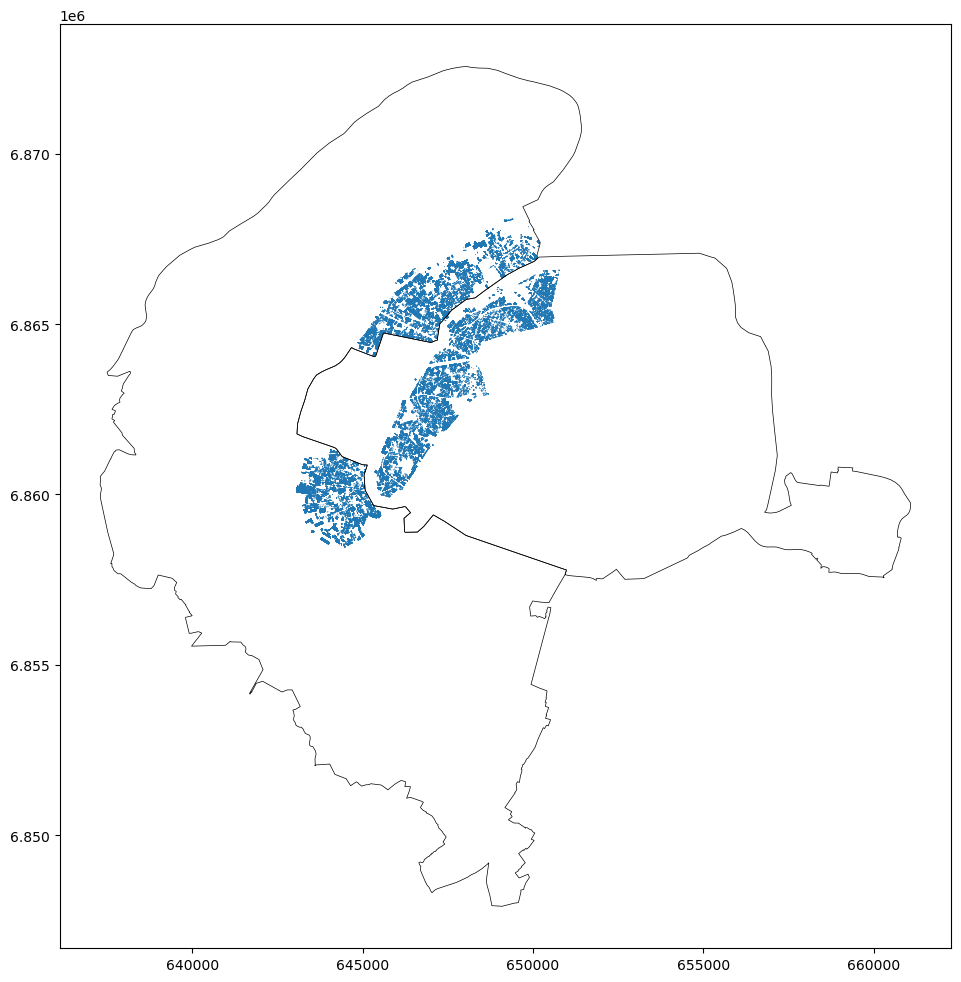

In [ ]:
idf = cartiflette.carti_download(
    values=["11"],
    crs=4326,
    borders="DEPARTEMENT",
    vectorfile_format="geojson",
    filter_by="REGION",
    source="EXPRESS-COG-CARTO-TERRITOIRE",
    year=2022,
)

departements_paris_92 = idf.loc[
    idf["INSEE_DEP"].isin(["75", "92"])
].to_crs(2154)

fig, ax = plt.subplots(figsize=(12, 12))
base = departements_paris_92.boundary.plot(ax=ax, edgecolor="black", linewidth=0.5, figsize=(10, 10))

data_mut_et_insee_pour_vis = data_mut_ouest_et_insee
data_mut_et_insee_pour_vis["geometry"] = data_mut_et_insee_pour_vis["geometry"].to_crs(2154)

data_mut_et_insee_pour_vis.plot(ax=ax)

plt.show()



On a sélectionné ici au début du code les villes de Vanves et Issy les Moulineaux, d'où le fait que les tâches de couleur s'affichent sur une zone localisée (uniquement les villes concernées)
= > il faudra ajuster l'API et le fond de carte selon la commune choisie, mais au moins on sait le faire fonctionner grosso modo

Isaure: On veut réaliser une carte interactive indiiquant le prix au mètre carré de chaque transactions sur la carte, on crée donc cette variable dans notre data_frame.

In [ ]:
# Calcul de prix_m2
data_mut_ouest_et_insee['prix_m2'] = data_mut_ouest_et_insee['valeurfonc'] / data_mut_ouest_et_insee['sbati']


On convertit toutes les géométries de multipolygon à point

In [ ]:

print(data_mut_ouest_et_insee.geometry.geom_type.unique())

data_mut_ouest_et_insee['geometry'] = data_mut_ouest_et_insee.geometry.centroid

print(data_mut_ouest_et_insee.geometry.geom_type.unique())



['MultiPolygon']
['Point']


On convertit la géométrie en données WGS 84 (coordonnées gps classiques) pour pouvoir la bibliothèque Folium de Python

In [ ]:

data_mut_ouest_et_insee = data_mut_ouest_et_insee.to_crs(epsg=4326)
print(data_mut_ouest_et_insee[['geometry']].head())


                   geometry
1   POINT (2.2624 48.88579)
2  POINT (2.27693 48.88565)
5  POINT (2.26639 48.87984)
8  POINT (2.26885 48.88763)
9   POINT (2.26731 48.8851)


on veut des cartes seulement pour 2019, 2020 et 2021.

In [ ]:
data_mut_ouest_et_insee['annee'] = data_mut_ouest_et_insee['datemut'].dt.year

annees_interet = [2019, 2020, 2021]
data_filtre_annees = data_mut_ouest_et_insee[data_mut_ouest_et_insee['annee'].isin(annees_interet)]


print(data_filtre_annees[['annee', 'prix_m2', 'geometry']].head())



   annee       prix_m2                  geometry
1   2021  11521.739130   POINT (2.2624 48.88579)
2   2021  13440.860215  POINT (2.27693 48.88565)
5   2021   9800.000000  POINT (2.26639 48.87984)
8   2021  15043.478261  POINT (2.26885 48.88763)
9   2021   8081.632653   POINT (2.26731 48.8851)


In [ ]:
# Filtrer les données par année
data_2019 = data_mut_ouest_et_insee[data_mut_ouest_et_insee['datemut'].dt.year == 2019]
data_2020 = data_mut_ouest_et_insee[data_mut_ouest_et_insee['datemut'].dt.year == 2020]
data_2021 = data_mut_ouest_et_insee[data_mut_ouest_et_insee['datemut'].dt.year == 2021]

print(f"2019 : {len(data_2019)}, 2020 : {len(data_2020)}, 2021 : {len(data_2021)}")


2019 : 10911, 2020 : 17746, 2021 : 10296


On crée une première carte avec des points en la centrant directement avec location = (48.89, 2.29), j'ai pris Levallois Perret

In [ ]:

import folium

# Fonction pour créer une carte
def create_map(data, year):
    m = folium.Map(location=[48.8918307474864, 2.292034072558762], zoom_start=16)  # Coordonnées centrées sur Paris
    for _, row in data.iterrows():
        folium.CircleMarker(
            location=[row.geometry.y, row.geometry.x],
            radius=5,
            color='blue',
            fill=True,
            fill_color='blue',
            fill_opacity=0.7,
            popup=f"Prix m² : {row['prix_m2']:.2f} €\nDate : {row['datemut']}"
        ).add_to(m)
    return m


carte_2019 = create_map(data_2019, 2019)
carte_2020 = create_map(data_2020, 2020)
carte_2021 = create_map(data_2021, 2021)

carte_2019


Pour une visualisation plus aérée et lisible, on prend un échantillon aléatoire de 10% des des données.

In [ ]:

reduced_data = data_mut_ouest_et_insee.sample(frac=0.1, random_state=42)


On fait une nouvelle carte avec des clusters

In [ ]:
from folium.plugins import MarkerCluster

m = folium.Map(location=[48.8918307474864, 2.29], zoom_start=16)
marker_cluster = MarkerCluster().add_to(m)

for _, row in reduced_data.iterrows():
    folium.Marker(
        location=[row.geometry.y, row.geometry.x],
        popup=f"Prix m² : {row['prix_m2']:.2f} €<br>Type : {row['libtypbien']}",
    ).add_to(marker_cluster)

m


# Analyse et statistiques descriptives : 

In [ ]:
print(data_mut_ouest_et_insee['libtypbien'].unique())


['UN APPARTEMENT' 'UNE MAISON']


/opt/conda/lib/python3.12/site-packages/geopandas/geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


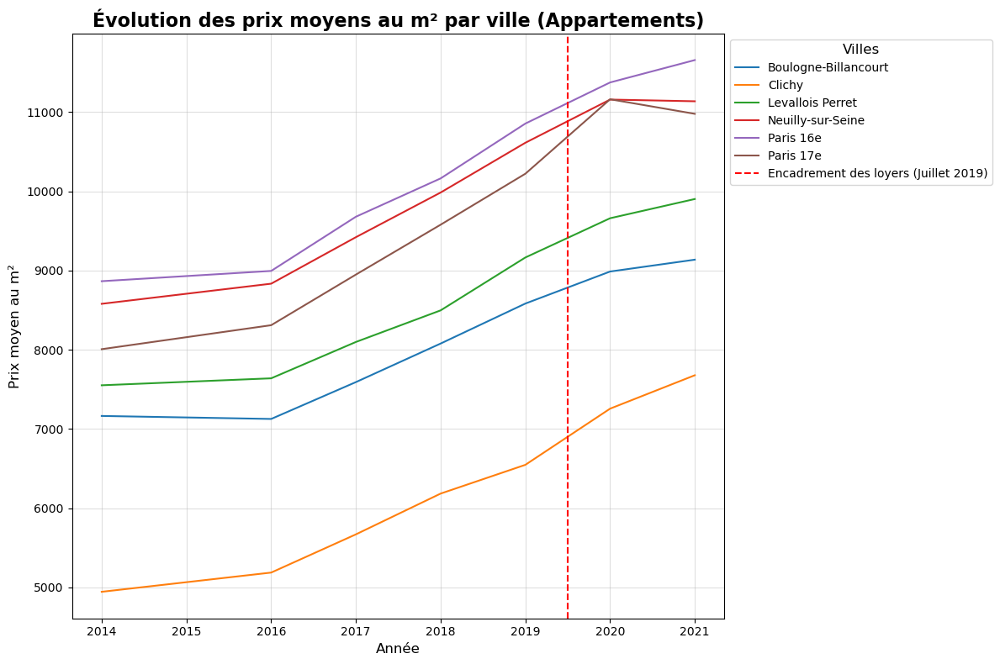

In [ ]:


import matplotlib.pyplot as plt

appartements = data_mut_ouest_et_insee[data_mut_ouest_et_insee['libtypbien'] == 'UN APPARTEMENT']

# Dictionnaire de correspondance correct entre codes INSEE et noms des villes
insee_to_ville = {
    "75116": "Paris 16e",
    "75117": "Paris 17e",
    "92012": "Boulogne-Billancourt",
    "92024": "Clichy",
    "92044": "Levallois Perret",
    "92051": "Neuilly-sur-Seine"
}


appartements['nom_ville'] = appartements['l_codinsee'].map(insee_to_ville)


stats_par_ville = appartements.groupby(['annee', 'nom_ville'])['prix_m2'].mean().reset_index()


plt.figure(figsize=(12, 8))
for ville in stats_par_ville['nom_ville'].unique():
    subset = stats_par_ville[stats_par_ville['nom_ville'] == ville]
    plt.plot(subset['annee'], subset['prix_m2'], label=ville)


plt.axvline(x=2019.5, color='red', linestyle='--', linewidth=1.5, label="Encadrement des loyers (Juillet 2019)")


plt.title("Évolution des prix moyens au m² par ville (Appartements)", fontsize=16, fontweight='bold')
plt.xlabel("Année", fontsize=12)
plt.ylabel("Prix moyen au m²", fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.legend(title="Villes", fontsize=10, title_fontsize=12, loc='upper left', bbox_to_anchor=(1, 1))  # Légende à l'extérieur
plt.grid(alpha=0.4)
plt.tight_layout()  
plt.show()




In [100]:
# Calcul de prix_m2
data_mut_sud_et_insee['prix_m2'] = data_mut_sud_et_insee['valeurfonc'] / data_mut_sud_et_insee['sbati']


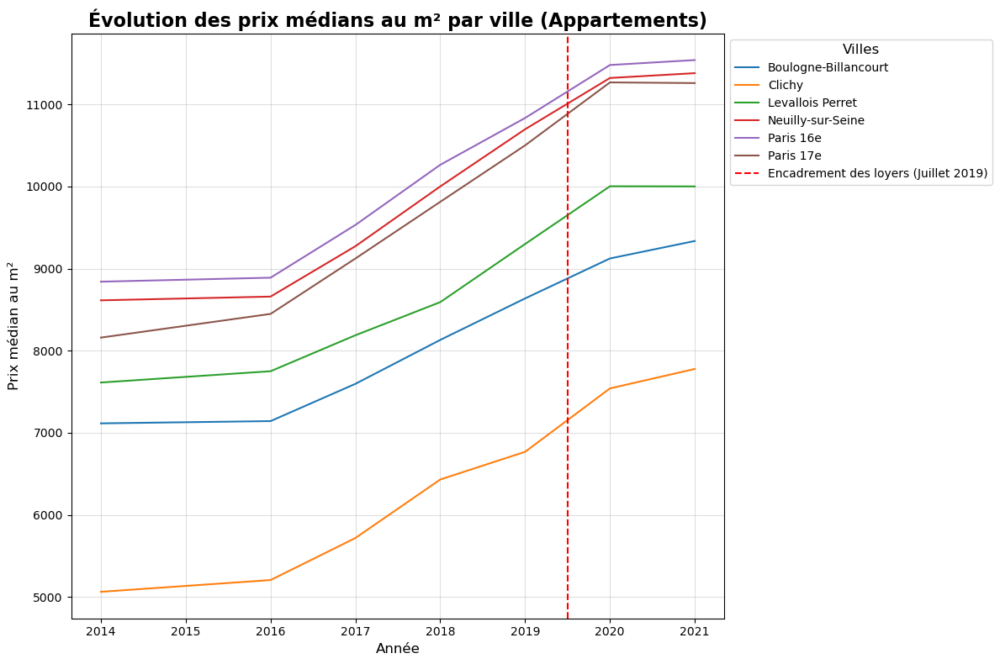

In [107]:
import matplotlib.pyplot as plt

# Filtrer uniquement les appartements
appartements = data_mut_ouest_et_insee[data_mut_ouest_et_insee['libtypbien'] == 'UN APPARTEMENT']

stats_median_par_ville = appartements.groupby(['annee', 'nom_ville'])['prix_m2'].median().reset_index()


plt.figure(figsize=(12, 8))


for ville in stats_median_par_ville['nom_ville'].unique():
    subset = stats_median_par_ville[stats_median_par_ville['nom_ville'] == ville]
    plt.plot(subset['annee'], subset['prix_m2'], label=ville)

plt.axvline(x=2019.5, color='red', linestyle='--', linewidth=1.5, label="Encadrement des loyers (Juillet 2019)")


plt.title("Évolution des prix médians au m² par ville (Appartements)", fontsize=16, fontweight='bold')
plt.xlabel("Année", fontsize=12)
plt.ylabel("Prix médian au m²", fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.legend(title="Villes", fontsize=10, title_fontsize=12, loc='upper left', bbox_to_anchor=(1, 1))  # Légende à l'extérieur
plt.grid(alpha=0.4)
plt.tight_layout()  
plt.show()




/opt/conda/lib/python3.12/site-packages/geopandas/geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


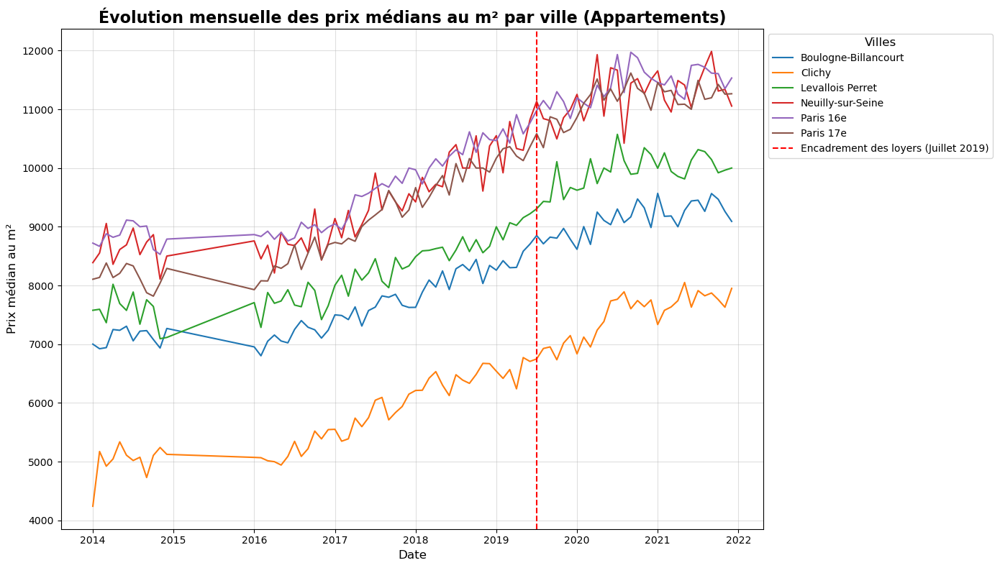

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

appartements = data_mut_ouest_et_insee[data_mut_ouest_et_insee['libtypbien'] == 'UN APPARTEMENT']


appartements['datemut'] = pd.to_datetime(appartements['datemut'])


appartements['annee'] = appartements['datemut'].dt.year
appartements['mois'] = appartements['datemut'].dt.month


stats_mensuelles = appartements.groupby(['annee', 'mois', 'nom_ville'])['prix_m2'].agg(['mean', 'median', 'std']).reset_index()


stats_mensuelles['date'] = stats_mensuelles['annee'] + (stats_mensuelles['mois'] - 1) / 12

plt.figure(figsize=(14, 8))
for ville in stats_mensuelles['nom_ville'].unique():
    subset = stats_mensuelles[stats_mensuelles['nom_ville'] == ville]
    plt.plot(subset['date'], subset['median'], label=ville)

plt.axvline(x=2019 + 6/12, color='red', linestyle='--', linewidth=1.5, label="Encadrement des loyers (Juillet 2019)")


plt.title("Évolution mensuelle des prix médians au m² par ville (Appartements)", fontsize=16, fontweight='bold')
plt.xlabel("Date", fontsize=12)
plt.ylabel("Prix médian au m²", fontsize=12)
plt.legend(title="Villes", fontsize=10, title_fontsize=12, loc='upper left', bbox_to_anchor=(1, 1))  # Légende à l'extérieur
plt.grid(alpha=0.4)
plt.tight_layout()
plt.show()



In [ ]:

appartements = data_mut_ouest_et_insee[data_mut_ouest_et_insee['libtypbien'] == 'UN APPARTEMENT']


date_limite = '2019-07-01'
periode_avant = '2018-07-01'
periode_apres = '2020-06-30'


avant = appartements[(appartements['datemut'] >= periode_avant) & (appartements['datemut'] < date_limite)]
apres = appartements[(appartements['datemut'] >= date_limite) & (appartements['datemut'] <= periode_apres)]


stats_avant = avant.groupby('nom_ville')['prix_m2'].agg(['mean', 'median']).rename(columns={"mean": "moyenne_avant", "median": "mediane_avant"})
stats_apres = apres.groupby('nom_ville')['prix_m2'].agg(['mean', 'median']).rename(columns={"mean": "moyenne_apres", "median": "mediane_apres"})

comparaison = pd.concat([stats_avant, stats_apres], axis=1)

print("Comparaison des prix moyens et médians avant et après juillet 2019 (Appartements uniquement) :")
print(comparaison)




Comparaison des prix moyens et médians avant et après juillet 2019 (Appartements uniquement) :
                      moyenne_avant  mediane_avant  moyenne_apres  \
nom_ville                                                           
Boulogne-Billancourt    8311.337060    8357.309606    8843.814574   
Clichy                  6361.214949    6548.387097    6840.572441   
Levallois Perret        8753.179906    8861.671123    9451.849022   
Neuilly-sur-Seine      10304.586380   10363.636364   10957.744024   
Paris 16e              10439.897295   10526.315789   11204.262803   
Paris 17e               9855.030995   10170.227273   10747.474679   

                      mediane_apres  
nom_ville                            
Boulogne-Billancourt    8888.888889  
Clichy                  7095.238095  
Levallois Perret        9780.000000  
Neuilly-sur-Seine      11084.337349  
Paris 16e              11131.006865  
Paris 17e              10966.304348  


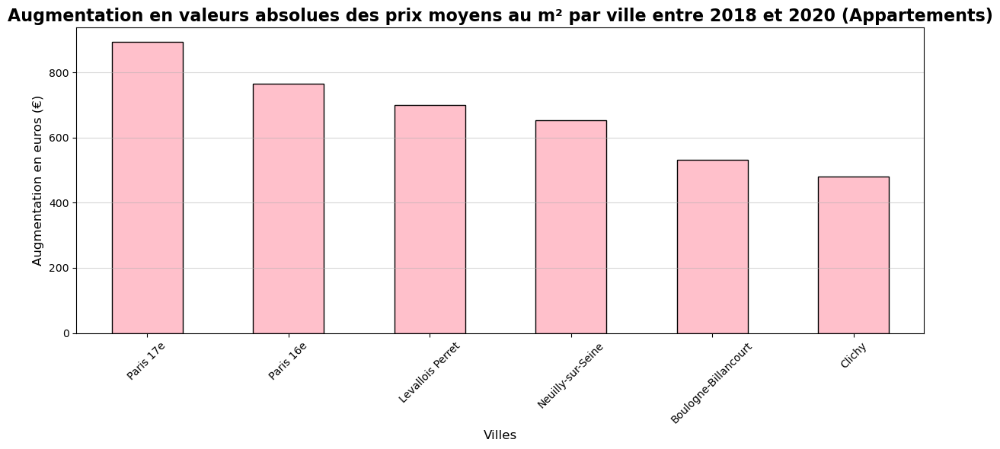

In [ ]:
import matplotlib.pyplot as plt


appartements = data_mut_ouest_et_insee[data_mut_ouest_et_insee['libtypbien'] == 'UN APPARTEMENT']


date_limite = '2019-07-01'
periode_avant = '2018-07-01'
periode_apres = '2020-06-30'


avant = appartements[(appartements['datemut'] >= periode_avant) & (appartements['datemut'] < date_limite)]
apres = appartements[(appartements['datemut'] >= date_limite) & (appartements['datemut'] <= periode_apres)]

stats_avant = avant.groupby('nom_ville')['prix_m2'].mean().rename("moyenne_avant")
stats_apres = apres.groupby('nom_ville')['prix_m2'].mean().rename("moyenne_apres")


comparaison = pd.concat([stats_avant, stats_apres], axis=1)


comparaison['augmentation_absolue'] = comparaison['moyenne_apres'] - comparaison['moyenne_avant']

comparaison_triee = comparaison.sort_values(by='augmentation_absolue', ascending=False)


plt.figure(figsize=(12, 6))
comparaison_triee['augmentation_absolue'].plot(kind='bar', color='pink', edgecolor='black')


plt.title("Augmentation en valeurs absolues des prix moyens au m² par ville entre 2018 et 2020 (Appartements)", fontsize=16, fontweight='bold')
plt.xlabel("Villes", fontsize=12)
plt.ylabel("Augmentation en euros (€)", fontsize=12)
plt.xticks(rotation=45, fontsize=10)
plt.grid(axis='y', alpha=0.5)
plt.tight_layout()
plt.show()




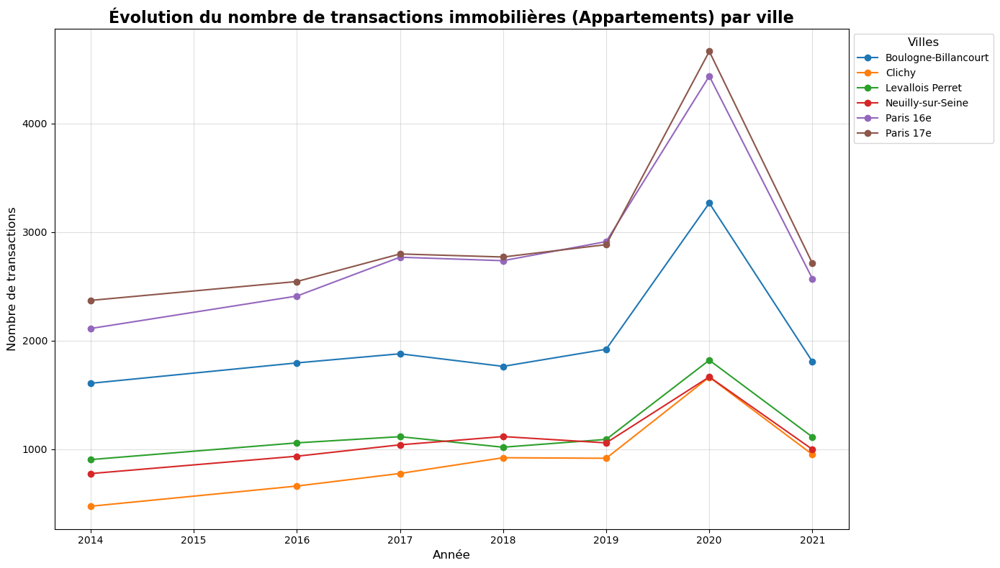

In [ ]:

appartements = data_mut_ouest_et_insee[data_mut_ouest_et_insee['libtypbien'] == 'UN APPARTEMENT']

# Comptage du nombre de transactions par ville et par année pour les appartements
transactions_par_ville = appartements.groupby(['annee', 'nom_ville']).size().reset_index(name='nombre_transactions')


plt.figure(figsize=(14, 8))
for ville in transactions_par_ville['nom_ville'].unique():
    subset = transactions_par_ville[transactions_par_ville['nom_ville'] == ville]
    plt.plot(subset['annee'], subset['nombre_transactions'], label=ville, marker='o')

plt.title("Évolution du nombre de transactions immobilières (Appartements) par ville", fontsize=16, fontweight='bold')
plt.xlabel("Année", fontsize=12)
plt.ylabel("Nombre de transactions", fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.legend(title="Villes", fontsize=10, title_fontsize=12, loc='upper left', bbox_to_anchor=(1, 1))  # Légende à l'extérieur
plt.grid(alpha=0.4)
plt.tight_layout()  # Ajustement pour éviter le chevauchement
plt.show()


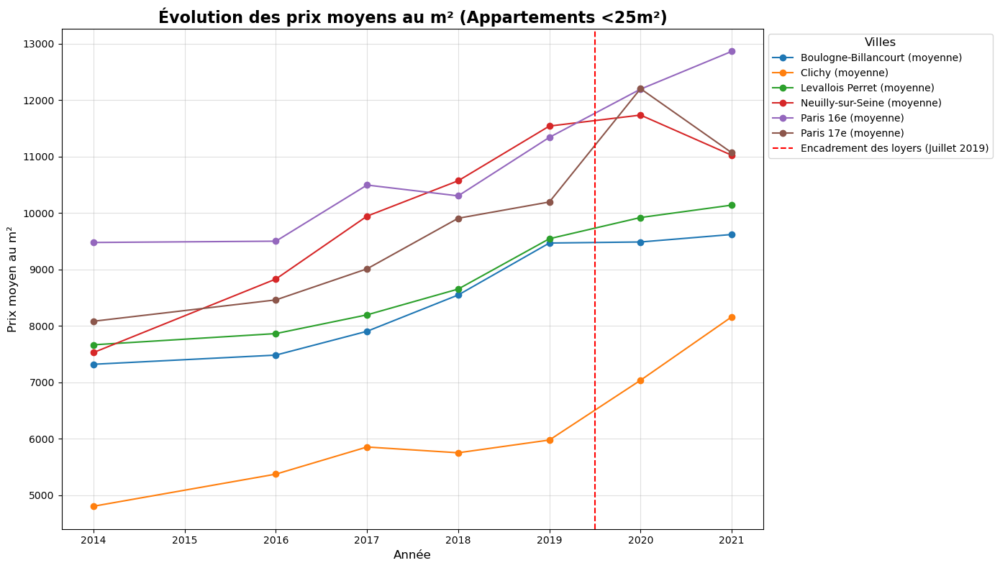

In [ ]:

plt.figure(figsize=(14, 8))
for ville in prix_par_ville['nom_ville'].unique():
    subset = prix_par_ville[prix_par_ville['nom_ville'] == ville]
    plt.plot(subset['annee'], subset['mean'], label=f"{ville} (moyenne)", marker='o')


plt.axvline(x=2019.5, color='red', linestyle='--', linewidth=1.5, label="Encadrement des loyers (Juillet 2019)")


plt.title("Évolution des prix moyens au m² (Appartements <25m²)", fontsize=16, fontweight='bold')
plt.xlabel("Année", fontsize=12)
plt.ylabel("Prix moyen au m²", fontsize=12)
plt.legend(title="Villes", fontsize=10, title_fontsize=12, loc='upper left', bbox_to_anchor=(1, 1))
plt.grid(alpha=0.4)
plt.tight_layout()
plt.show()



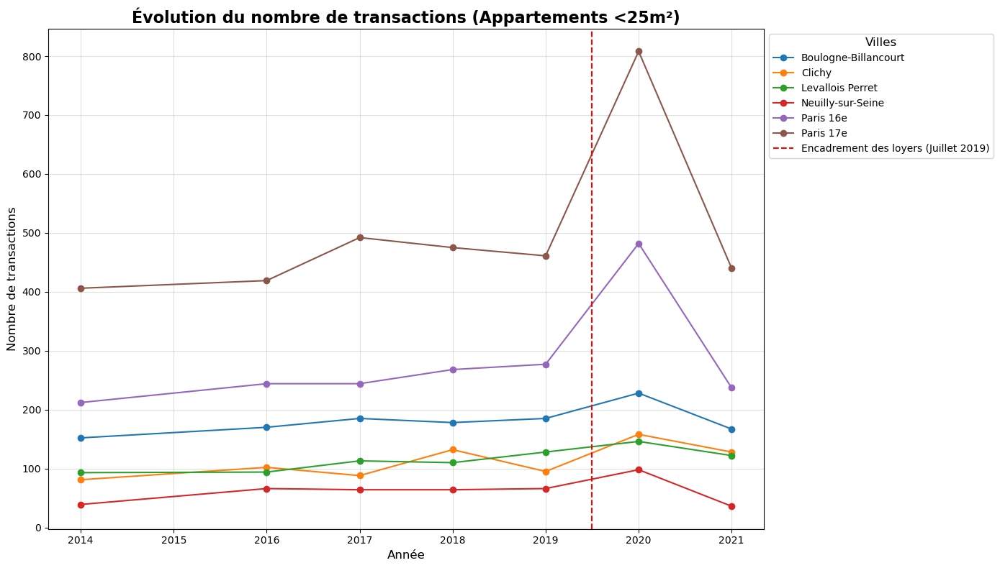

In [ ]:

plt.figure(figsize=(14, 8))
for ville in transactions_petits['nom_ville'].unique():
    subset = transactions_petits[transactions_petits['nom_ville'] == ville]
    plt.plot(subset['annee'], subset['nombre_transactions'], label=ville, marker='o')

plt.axvline(x=2019.5, color='red', linestyle='--', linewidth=1.5, label="Encadrement des loyers (Juillet 2019)")


plt.title("Évolution du nombre de transactions (Appartements <25m²)", fontsize=16, fontweight='bold')
plt.xlabel("Année", fontsize=12)
plt.ylabel("Nombre de transactions", fontsize=12)
plt.legend(title="Villes", fontsize=10, title_fontsize=12, loc='upper left', bbox_to_anchor=(1, 1))
plt.grid(alpha=0.4)
plt.tight_layout()
plt.show()

# Differences in differences

On cherche à appliquer ce modèle à deux ensembles : l'Ouest parisien et le Sud parisien. Dans chaque ensemble, on établit un groupe "contrôle" (villes en bordures du périphérique) et un groupe "traitement" (arrondissements parisiens en bordure du périphérique). 

In [ ]:
print(data_mut_ouest_et_insee['coddep'].unique())

['92' '75']


In [ ]:
crtl_sud = data_mut_ouest_et_insee[data_mut_ouest_et_insee['coddep']=='92']
trtm_sud = data_mut_ouest_et_insee[data_mut_ouest_et_insee['coddep']=='75']

In [ ]:
print(list(data_mut_ouest_et_insee.columns))

['idmutinvar', 'idopendata', 'datemut', 'anneemut', 'coddep', 'libnatmut', 'vefa', 'valeurfonc', 'nbcomm', 'l_codinsee', 'nbpar', 'l_idpar', 'nbparmut', 'sterr', 'nbvolmut', 'nblocmut', 'l_idlocmut', 'sbati', 'codtypbien', 'libtypbien', 'geometry', 'index_right', 'geo_point', 'dep', 'insee_com', 'nom_com', 'iris', 'code_iris', 'nom_iris', 'typ_iris', 'IRIS', 'COM_x', 'TYP_IRIS_x', 'LAB_IRIS_x', 'P_POP1564', 'P_POP1524', 'P_POP2554', 'P_POP5564', 'P_H1564', 'P_H1524', 'P_H2554', 'P_H5564', 'P_F1564', 'P_F1524', 'P_F2554', 'P_F5564', 'P_ACT1564', 'P_ACT1524', 'P_ACT2554', 'P_ACT5564', 'P_HACT1564', 'P_HACT1524', 'P_HACT2554', 'P_HACT5564', 'P_FACT1564', 'P_FACT1524', 'P_FACT2554', 'P_FACT5564', 'P_ACTOCC1564', 'P_ACTOCC1524', 'P_ACTOCC2554', 'P_ACTOCC5564', 'P_HACTOCC1564', 'P_HACTOCC1524', 'P_HACTOCC2554', 'P_HACTOCC5564', 'P_FACTOCC1564', 'P_FACTOCC1524', 'P_FACTOCC2554', 'P_FACTOCC5564', 'P_CHOM1564', 'P_CHOM1524', 'P_CHOM2554', 'P_CHOM5564', 'P_INACT1564', 'P_HINACT1564', 'P_FINACT15

In [ ]:
import statsmodels.formula.api as sm
data_mut_ouest_et_insee['prix_m2'] = data_mut_ouest_et_insee['valeurfonc'] / data_mut_ouest_et_insee['stot']


In [ ]:
print(list(data_mut_ouest_et_insee['DISP_MED'].unique()))

['37090', '37000', '36600', '39310', '38430', '36720', '44850', '37240', '34640', '31650', '38840', '37550', '31010', '24370', '43030', '30230', '41820', '31980', '22440', '37740', '41200', '20920', '35010', '30990', '36360', '40210', '40600', '37810', '21410', '36530', '35890', '35510', '36650', '36800', '43390', '32630', '30750', '35990', '24010', '31100', '37780', '20830', '35830', '41600', '29010', 30500, 37530, 35980, 36640, 36310, 33240, 39370, 36830, 35470, 30000, 35940, 38910, 35450, 34830, 44170, 35460, 40730, 30780, 23500, 20110, 36720, 20630, 28550, 30310.0, 36340.0, 34780.0, 36240.0, 35420.0, 40140.0, 32650.0, 37710.0, 41790.0, 20050.0, 35070.0, 35390.0, 35860.0, 35680.0, 33700.0, 44050.0, 29270.0, 38010.0, 35920.0, 29890.0, 20330.0, 22750.0, 29250.0, 21160.0, 38880.0, 35440.0, 31370.0, 33900.0, 42020.0, 34800.0, 35300.0, 28510.0, 34470.0, 27780.0, 33510.0, 36760.0, 29260.0, 28760.0, 34410.0, 32120.0, 34590.0, 34460.0, 39630.0, 19670.0, 19790.0, 34560.0, 29420.55555555556, 

In [ ]:
print(len(data_mut_ouest_et_insee))
def est_un_nombre(valeur):
    try:
        a = str(valeur).replace(',', ".")
        float(a)
        return True
    except ValueError:
        return False

# Filtrage pour ne garder que les valeurs convertibles en nombre
data_mut_ouest_et_insee = data_mut_ouest_et_insee[data_mut_ouest_et_insee['DISP_MED'].apply(est_un_nombre)]
print(len(data_mut_ouest_et_insee))

77753
77368


In [ ]:
data_mut_ouest_et_insee['DISP_MED'] = data_mut_ouest_et_insee['DISP_MED'].astype(float)

In [ ]:
print(data_mut_ouest_et_insee["DISP_MED"].mean())

36878.01222831851


In [ ]:
result = sm.ols(formula="prix_m2 ~ P_ACT1564 + P_CHOM1564 + C_ACT1564_CS3 + P_H1564 + P_MAISON", data=data_mut_ouest_et_insee).fit()
print(result.params)

Intercept        10067.507638
P_ACT1564           -5.170967
P_CHOM1564          -6.577778
C_ACT1564_CS3        4.966894
P_H1564              5.025007
P_MAISON           -10.293793
dtype: float64


In [ ]:
print(result.pvalues)

Intercept         0.000000e+00
P_ACT1564        1.689695e-224
P_CHOM1564        2.194438e-48
C_ACT1564_CS3     0.000000e+00
P_H1564          6.424116e-129
P_MAISON          1.649687e-86
dtype: float64


In [ ]:
print(crtl_sud['anneemut'].unique())

['2021' '2020' '2019' '2018' '2017' '2016' '2014']


In [ ]:
crtl_sud_an = {}
for annee in crtl_sud['anneemut'].unique() : 
    crtl_sud_an[annee] = crtl_sud[crtl_sud['anneemut']==annee]

In [ ]:
for annee in crtl_sud['anneemut'].unique() :
    print(annee)
    df = crtl_sud_an[annee]
    pred = result.params["Intercept"] 
    for covar in ["P_CHOM1564",'C_ACT1564_CS3', 'P_H1564', "P_MAISON", "P_ACT1564"]:
        pred +=  result.params[covar]*df[covar].mean()
    print((df['prix_m2'].mean() - pred)/df['prix_m2'].mean())  

2021
0.04354295697146256
2020
0.034470452139881466
2019
-0.014488181484985218
2018
-0.07779534283315664
2017
-0.13118616308008751
2016
-0.19788295296294692
2014
-0.20028479573360694


In [ ]:
trtm_sud_an = {}
for annee in trtm_sud['anneemut'].unique() : 
    trtm_sud_an[annee] = trtm_sud[trtm_sud['anneemut']==annee]
for annee in trtm_sud['anneemut'].unique() :
    print(annee)
    df = trtm_sud_an[annee]
    pred = result.params["Intercept"] 
    for covar in ["P_CHOM1564",'C_ACT1564_CS3', 'P_H1564', "P_MAISON", "P_ACT1564"]:
        pred +=  result.params[covar]*df[covar].mean()
    print((df['prix_m2'].mean() - pred)/df['prix_m2'].mean())  

2021
0.15085706401347315
2020
0.14892209034741108
2019
0.09667441835684198
2018
0.0352714243662213
2017
-0.016093283500236366
2016
-0.09037022242254308
2014
-0.11781714588893903


In [ ]:
isaure

NameError: name 'isaure' is not defined

In [ ]:
data_mut_ouest_et_insee.columns


Index(['idmutinvar', 'idopendata', 'datemut', 'anneemut', 'coddep',
       'libnatmut', 'vefa', 'valeurfonc', 'nbcomm', 'l_codinsee',
       ...
       'P_ANEM_RP_GRAT', 'P_RP_SDB', 'P_RP_CCCOLL', 'P_RP_CCIND',
       'P_RP_CINDELEC', 'P_RP_GARL', 'P_RP_VOIT1P', 'P_RP_VOIT1',
       'P_RP_VOIT2P', 'stot'],
      dtype='object', length=238)

In [ ]:
# Créer une copie pour travailler
data_diff = data_mut_ouest_et_insee.copy()

# Ajouter une colonne "groupe"
data_diff['groupe'] = data_diff['l_codinsee'].apply(
    lambda x: 'traitement' if x in ['75116', '75117'] else 
              'controle' if x in ['92012', '92024', '92044', '92051'] else 
              'hors_etude'
)

# Filtrer uniquement les groupes traitement et contrôle
data_diff = data_diff[data_diff['groupe'] != 'hors_etude']


In [ ]:

cutoff_date = pd.to_datetime("2019-07-01")

data_diff['periode'] = data_diff['datemut'].apply(
    lambda x: 'avant' if x < cutoff_date else 'apres'
)
print(data_diff[['datemut', 'periode']].head())



     datemut periode
1 2021-03-18   apres
2 2021-06-02   apres
4 2021-02-26   apres
6 2021-05-11   apres
7 2021-04-14   apres


In [ ]:
print(data_diff['periode'].value_counts())


periode
avant    47195
apres    35835
Name: count, dtype: int64


In [ ]:
# Encodage binaire pour traitement et après
data_diff['traitement'] = (data_diff['groupe'] == 'traitement').astype(int)
data_diff['apres'] = (data_diff['periode'] == 'apres').astype(int)

# Vérifions les nouvelles colonnes
print(data_diff[['groupe', 'periode', 'traitement', 'apres']].head())


       groupe periode  traitement  apres
1  traitement   apres           1      1
2  traitement   apres           1      1
4  traitement   apres           1      1
6  traitement   apres           1      1
7  traitement   apres           1      1


In [ ]:
print(data_diff['traitement'].value_counts())
print(data_diff['apres'].value_counts())


traitement
1    44028
0    39002
Name: count, dtype: int64
apres
0    47195
1    35835
Name: count, dtype: int64


In [ ]:
print(data_diff.info())


<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 83030 entries, 1 to 109676
Columns: 242 entries, idmutinvar to apres
dtypes: datetime64[ms](1), float64(184), geometry(1), int64(2), object(54)
memory usage: 153.9+ MB
None


In [ ]:
print(data_diff.groupby(['groupe', 'periode']).size())



groupe      periode
controle    apres      17089
            avant      21913
traitement  apres      18746
            avant      25282
dtype: int64


In [ ]:
variables_controle = ['DISP_MED', 'DISP_RD', 
                      'P_ACT1564', 'P_CHOM1564', 
                      'P_RP_4060M2', 'P_RP_6080M2', 
                      'P_RP_PROP', 'P_RP_LOC', 
                      'P_ANEM_RP']


In [ ]:
with open("colonnes_data.txt", "w") as f:
    for col in data_mut_ouest_et_insee.columns:
        f.write(col + "\n")





In [ ]:

# Calculer le prix au m²
data_diff['prix_m2'] = data_diff['valeurfonc'] / data_diff['sbati']

# Vérifier un aperçu des données
print(data_diff[['valeurfonc', 'sbati', 'prix_m2']].head())


   valeurfonc  sbati       prix_m2
1    451000.0   30.0  15033.333333
2    701780.0   50.0  14035.600000
4    213650.0   19.0  11244.736842
6    854009.0   77.0  11091.025974
7    335000.0   34.0   9852.941176


In [ ]:
import statsmodels.formula.api as smf

# Formuler le modèle Diff-in-Diff avec variables de contrôle
formule = 'prix_m2 ~ traitement + apres + traitement:apres + ' + ' + '.join(variables_controle)

# Ajuster le modèle
modele = smf.ols(formula=formule, data=data_diff).fit()

# Résultats
print(modele.summary())


ValueError: mismatch between column_names and columns coded by given terms

In [ ]:
# Vérifiez les valeurs manquantes dans les colonnes utilisées
missing_values = data_diff[variables_utilisees].isnull().sum()
print("Valeurs manquantes par colonne :")
print(missing_values)


Valeurs manquantes par colonne :
prix_m2          0
traitement       0
apres            0
DISP_MED       274
DISP_RD        274
P_ACT1564        0
P_CHOM1564       0
P_RP_4060M2      0
P_RP_6080M2      0
P_RP_PROP        0
P_RP_LOC         0
P_ANEM_RP        0
dtype: int64


In [ ]:
data_diff_clean = data_diff.dropna(subset=variables_utilisees)


In [ ]:
# Liste des colonnes utilisées dans la formule
variables_utilisees = ['prix_m2', 'traitement', 'apres'] + variables_controle

# Vérifiez si toutes ces colonnes existent dans data_diff
missing_columns = [col for col in variables_utilisees if col not in data_diff.columns]
print("Colonnes manquantes :", missing_columns)


Colonnes manquantes : []
